# Final Workflow StatsLab

### Contents:
* [0. Overview](#overview)
    * [Our Objective](#objective)
    * [Gaussian Processes and Implementation](#gaussian-processes)
    * [Model Inputs and Outputs](#mod-in-out)
    * [Using This File to Identify Hotspots](#hotspots)
* [1. Helper Functions](#helpers)
* [2. Plots](#plots)
* [3. Workflow Illustration](#workflow)
    * [3.0 Preprocessing Data](#prepro)
    * [3.1 Fitting the Model from Scratch](#scratch)
    * [3.2 Plotting Previous Results](#plot-previous)
    * [3.3 Comparing Models in Different Time Brackets](#time-comparison)

## 0. Overview <a class="anchor" id="overview"></a>

### Objective: Determine Whether PM2.5 Hotspots are Genuine <a class="anchor" id="objective"></a>

Our main objective is to devise a method for assessing the confidence that an identified hotspot is a genuine hotspot, in the context of PM2.5 air pollution. We use data collected in Kigali, Rwanda, in September 2021. The team at Open Seneca fitted sensors to the bikes of twenty local delivery drivers, and gathered data about the ambient PM2.5 pollution they encountered over the course of the month. Keep in mind, though, that the _method_ we devise to identify genuine hotspots is more relevant than the genuine hotspots we identify in Kigali. We intend that the method be applicable to Open Seneca’s PM2.5 data from other cities.

The ‘hotspots’ are neighborhoods more polluted than some baseline level in the surrounding city. Just looking at the locations with the highest pollution measurements does not immediately reveal all hotspots. Pollution follows several temporal patterns, so one must adjust for the time at which measurements are made. Measurements are also geographically sparse; in a short time frame, the delivery drivers will only travel on so many roads. In order to make city-wide pollution comparisons, one must therefore leverage the available data to make predictions about the un-measured neighborhoods.

We propose adjusting for the temporal pattern by de-trending the data. Three baselines are computed: a 15-minute baseline, a daily baseline, and a baseline combining these two. A baseline is the rolling average of all measurements in the given time period. According to the number of active measurement devices and the dynamics of pollution in the city, an analyst can choose which of these baselines is most appropriate - and subtract it from the measurements to de-trend them.

Then we fit a Gaussian Process model, with PM2.5 pollution as the dependent variable and latitude & longitude as the independent variables. The idea is that we estimate a flexible regression surface across the whole city of Kigali for the mean pollution level in each spot. Equipped with a prior distribution, the Gaussian Process model allows for the construction of confidence intervals, and thus the assessment of how likely it is that any point in the city is a genuine hotspot. 

_Please consult the Gaussian Processes handout for technical details!_


### Using Gaussian Process Regression to Identify Air Pollution Hotspots <a class="anchor" id="gaussian-processes"></a>

To use gaussian process regression to identify airquality hotspots specifically, we have to overcome a few problems
- Number of observations (GP regression has complexity of $\mathcal{O}(n^3)$ so using all observations is not feasible) 
- Sparsity of extreme values (random subsampling to solve the complexity issue is not sufficient) 
- Kernel choice to encode a priori assumption on true surface of air pollution

In the following, we quickly address how we solve these three main problems and how they are implemented.
We employ an ensemble of gaussian processes regressions on subsamples of the data to reduce the run-time 
complexity. In the same step, we address the sparsity issue. 

The steps detailed in the following are all implemented in the `fitting_process()` function, which additionally pulls `calculate_pollution_levels()` and `stratified_sampling()`. Firstly, we divide the
data into 2-hourly time brackets to investigate the influence of time-of-day on the hotspots. We then
run the entire procedure for these brackets seperately. If one is not interested in the 
time-of-day variation, one can combine the results from the different time brackets in the end.
To address the sparsity issue, we do not employ random subsampling but stratified subsampling. 
To do so, we divide the city into tiles of size $250 m^2$ and compute the median pollution level per tile. 
Then, we subsample data by oversampling from low and high median pollution tiles. The percentiles (what is considered to be low or high pollution) can be chosen by `p_low`, `p_high`. The fractions of observations from low, medium and high median pollution levels in each subsample can be adjusted using `sample_frac_low`, `sample_frac_medium` and `sample_frac_high` (they need to sum to $1$). For each subsample, we then run a gaussian
process regression using the exponential kernel while optimizing the hyperparameters ($\sigma^2, \sigma_k^2, l$) via cross-validation.
We choose the exponential kernel as our a priori belief on the surface of pollution levels
is that is should be spikey and not overly smooth, which is encoded in the exponential
kernel, given by:
$$ k(x,y) = \sigma_k^2\exp\left(\frac{\lVert x-y\rVert_1}{l}\right).$$

If a smoother surface is desired, one can use the radial basis kernel, denoted `SquaredExponential` in GPFlow. Then, the models are evaluated on an equi-spaced grid over the city meaning we 
compute the predicted value and the variance of the predicted value for all the test points. Then, all the $B$ models within each bracket
are combined into one predicted value and respective variance per test point. This is done via:
$$\hat{f}_i = \frac{1}{B}\sum_{b=1}^B\hat{f}_{i,b}, i = 1,\dots,n\\
  \hat{\sigma}^2_i = \frac{1}{B}\sum_{b=1}^B\hat{\sigma}^2_{i,b} + \frac{1}{B}\sum_{b=1}^B(\hat{f}_{i,b}-\hat{f}_i)^2, i =1,\dots,n.
$$
The second term in the calculation of the variance captures the covariances between the different fitted models. If one is willing to assume independence (due to potentially non-overlapping subsamples of the data), one can specify this using `independence = True`, which negletcs the second term, thus decreasing the variance.

Knowing that all marginal distributions of this surface are normal random variables (gaussian), we can compute the z values by via:
$$z_i = \frac{\hat{f}_i - \operatorname{median}(pm_{2.5})}{\sqrt{\hat{\sigma}^2_i}}, i = 1,\dots,n. $$
We can then test for hotspots using the fact that $(z_i)_{i=1}^n$ are standard-normal random variables. Concretely, this means we test:
$$ H_0: z_i = \operatorname{median}(pm_{2.5})\ \textrm{vs.}\ H_1: z_i \geq \operatorname{median}(pm_{2.5}), i=1,\dots,n.$$
The null-hypothesis $H_0$ is rejected at level $\alpha$ if $z_i \geq \Phi^{-1}(1-\alpha)$, where $\Phi(\cdot)$ denotes the cdf of a standard normal random variable.

If one is not interested in the different time brackets, one can then average the predicitions and variances
for the different time brackets to get the overall hotspot measure, as is explained below.

### Model Inputs and Outputs <a class="anchor" id="mod-in-out"></a>

#### Model Inputs

Below we explain a handful of our parameter choices when we performed the modelling. To see all parameter definitions, consult [the definition](#helpers) of the `fitting_process()` function. To see the default parameters we used when calling the `fitting_process()` function, please refer to the workflow illustration in [section 3.1](#scratch). 
* `response` indicates the variable being modelled. We chose `pm25_detrended_15` corresponding to the 15-minute baseline. Other options are `pm25_detrended_day` corresponding to a daily baseline, and `pm25_detrended_comb` which averages these two baselines
* `iterations`: the number of fitted models; we chose 100. The higher the number of iterations, the more accurate the estimate, but the longer the computational time.
* `independence` a binary variable: `True` if one believes the bagged models are independent, `False` otherwise. We suggest using `False` for a more conservative estimate of the hotspot locations. Assuming independence will lead to lower variances and hence the identification of more hotspots. 
* `grid` corresponds to the size of the test dataset grid. A higher number provides a more granular prediction surface.


#### Model Outputs

`fitting_process()` outputs three dictionaries and a DataFrame, `df_res`. The first three dictionaries contain models, predicted values and variances for each two-hour time bracket (e.g., the "06:00:00" time bracket contains the outputs of a model run on all observations between "06:00:00" and "08:00:00", irrespective of the date). The DataFrame `df_res` contains predicted values and variances aggregated across all time brackets. Consult [the definition](#helpers) of `fitting_process()` for further explanation of the model outputs.

### How to Find Hotspots From the File <a class="anchor" id="hotspots"></a>

To identify hotspots from the data, we can use the `df_res` output from the `fitting_process()` function (the fourth output from the function). `df_res` is a data frame that contains latitude, longitude, predicted values, predicted variances and z-values for an equispaced grid of latitude/longitude test points over the city. A point that is significant at level $\alpha$ has a z-value higher than the 1-$\alpha$ quantile of the standard-normal distribution. For $\alpha = 0.05$, this corresponds to a z-value greater than 1.65. For $\alpha = 0.01$, this corresponds to a z-value greater than $2.33$. Filtering `df_res` for lat/lon pairs with z-values higher than this threshold will identify hotspots in the city. The greater the z-value, the more of a “hotpot” the point is. Note that we could also identify “low spots”, ie points with significantly low levels of pollution, by taking lat/lon pairs with very low z-values.

The functions `plot_zvalues_or_predictions()` and `plot_contours()` can be used for easy visualization of the hotspots. The function `plot_zvalues_or_predictions()` plots the z-values over a map of the city, with shades of red indicating higher z-values (hence more of a hotspot). `plot_contours` gives a contour map of the z-values but without being overlaid on a map of the city. `plot_contours()` also highlights in black outline areas that classify as hotspots at a particular confidence level by setting the “alpha” argument. Note that the functions can also be used to plot the predicted pollution levels by setting the “level” argument; however, plotting z-value makes more sense for hotspot identification.  

In [33]:
#!pip install gpflow
#!pip install folium
#!pip install pysal
#!pip install selenium

  Using cached websocket_client-1.8.0-py3-none-any.whl.metadata (8.0 kB)
   ---------------------------------------- 0.0/9.6 MB ? eta -:--:--
   ----- ---------------------------------- 1.3/9.6 MB 42.0 MB/s eta 0:00:01
   -------------------------------- ------- 7.7/9.6 MB 83.1 MB/s eta 0:00:01
   ---------------------------------------- 9.6/9.6 MB 68.4 MB/s eta 0:00:00
   ---------------------------------------- 0.0/476.0 kB ? eta -:--:--
   ---------------------------------------- 476.0/476.0 kB ? eta 0:00:00
Using cached websocket_client-1.8.0-py3-none-any.whl (58 kB)
   ---------------------------------------- 0.0/181.4 kB ? eta -:--:--
   --------------------------------------- 181.4/181.4 kB 10.7 MB/s eta 0:00:00
   ---------------------------------------- 0.0/58.3 kB ? eta -:--:--
   ---------------------------------------- 58.3/58.3 kB 3.2 MB/s eta 0:00:00
   ---------------------------------------- 0.0/117.6 kB ? eta -:--:--
   ---------------------------------------- 117.6/11

In [13]:
from typing import Sequence

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
plt.style.use('seaborn-v0_8-white')
from matplotlib.colors import ListedColormap

import time
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
import statistics
import seaborn as sns
import tensorflow as tf
import pyproj
import gpflow
import warnings
import io
from PIL import Image

import os
import sys
import subprocess

from scipy.cluster.vq import kmeans

import folium
from folium.plugins import HeatMap
import branca.colormap as cm
from branca.colormap import linear
from branca.colormap import StepColormap

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import jaccard_score

import statsmodels.api as sm
import pickle

import scipy.stats as sps
import math
from tqdm import tqdm
tqdm.pandas()
# %matplotlib notebook
  
from haversine import haversine, Unit
from pandas.errors import SettingWithCopyWarning

warnings.filterwarnings('ignore', category=SettingWithCopyWarning)

os.chdir(r"C:\Users\nial\OneDrive\ETH Zürich\Statslab 2024\Kigali")

## 1. Helper Functions <a class="anchor" id="helpers"></a>

In [2]:
def data_cleanse(R_script_path, R_program_filepath, R_pkgs_filepath, alldata_filepath, data_cleaned_filepath):
    """
    A wrapper for running data_preprocess.R straight from this workbook. 
    Data_preprocess.R is an R script which preprocesses ('cleans') the raw data.
    Note: you do not need to run this function if you already have the cleaned data!

    INPUTS: 
    R_script_path: absolute filepath of data_preprocess.R (str)
    R_program_filepath: absolute filepath of the folder containing the latest R installation (str)
    R_libs_filepath: absolute filepath of the folder containing R packages (str)
    alldata_filepath: absolute filepath of alldata.csv (str)
    data_cleaned_filepath: absolute filepath to which data_cleaned.csv will be written (str)

    OUTPUTS:
    No return value. But produces a .csv file specified by data_cleaned_filepath for the 'cleaned' data.
    """
    sys.path.append(R_program_filepath)
    os.environ['R_LIBS'] = R_pkgs_filepath
    subprocess.run(['Rscript', R_script_path, alldata_filepath, data_cleaned_filepath])

In [3]:
def calculate_pollution_levels(tiles_df):
    
    """ This function computes the median pollution level per tile (250m^2) and adds it as a variable """

    tile_stats = tiles_df.groupby("tile_id")["pm25_detrended_15"].agg(["mean", "std"]).reset_index()
    tiles_df = tiles_df.merge(tile_stats, on = "tile_id")
    tiles_df["pollution_level"] = tiles_df["mean"]/ tiles_df["std"]
    return tiles_df

In [4]:
def stratified_sampling(df, p_low, p_high, sample_frac_low, sample_frac_medium,
                        sample_frac_high, add_covariates, response, size_subsample):
    
    """ 
        This function subsamples size_subsample number of observations while oversampling low and high pollution
        area, which are determined via p_low, p_high (percentiles of median pollution per tile). Sample_frac determine
        the composition of the size_subsample observations regarding low, medium and high pollution. Add covariates adds
        further covariates from osm and response chooses the response variable. Return X, Y for GP.
    """
    
    # Calculate the pollution levels for each tile
    df_poll = calculate_pollution_levels(df)
    df_poll = df_poll.dropna(subset=["pollution_level"])

    # Calculate the percentile pollution levels and split into groups
    p_low_value = np.percentile(df_poll["pollution_level"], p_low)
    p_high_value = np.percentile(df_poll["pollution_level"], p_high)

    low_pollution_tiles = df_poll[df_poll["pollution_level"] < p_low_value]
    medium_pollution_tiles = df_poll[(df_poll["pollution_level"] >= p_low_value) & (df_poll["pollution_level"] < p_high_value)]
    high_pollution_tiles = df_poll[df_poll["pollution_level"] > p_high_value]

    # Determine the sample size for each stratum
    total_sample_size = size_subsample * (sample_frac_low + sample_frac_medium + sample_frac_high)
    low_pollution_sample_size = int(total_sample_size * sample_frac_low)
    medium_pollution_sample_size = int(total_sample_size * sample_frac_medium)
    high_pollution_sample_size = int(total_sample_size * sample_frac_high)

    # Use stratified random sampling to select samples from each stratum
    low_pollution_sample = low_pollution_tiles.sample(n=low_pollution_sample_size, replace=False)
    medium_pollution_sample = medium_pollution_tiles.sample(n=medium_pollution_sample_size, replace=False)
    high_pollution_sample = high_pollution_tiles.sample(n=high_pollution_sample_size, replace=False)

    # Combine the samples from each stratum to obtain the final sample
    final_sample = pd.concat([low_pollution_sample, medium_pollution_sample, high_pollution_sample])
    
    # Get the X and Y arrays
    if add_covariates == False:
        X = final_sample[["lat","lon"]].to_numpy()
    else: 
        X= final_sample[["lat", "lon", "industrial", "major.road", "res.road"]].to_numpy()
    
    Y = final_sample[[response]].to_numpy()
    return X, Y

In [5]:
def fitting_process(response, iterations, p_low, p_high, sample_frac_low, sample_frac_medium, sample_frac_high,
                    add_covariates, size_subsample, grid, independence):
    
    """ 
        This function fits and evaluates the models on the test points.
        
        INPUTS:
        response:       detrended pm 2.5 (either "pm25_detrended_15" or "pm25_detrended_day")
        iterations:     number of iterations (total number of GP fitted)
        p_low:          lower cut-off in terms of percentile of median pollution level per tile for the stratified sampling (in [0,100])
        p_high:         higher cut-off in terms of percentile of median pollution level per tile for the stratified sampling (in [0,100])
        sample_frac_low, sample_frac_medium, sample_frac_high: 
                        perc. of obs from low, medium and high pollution levels (sum to 1)
        add_covariates: use street variables in estimation (True or False)
        size_subsample: number of observations per model
        grid:           sqrt(desired number of test observations)
        independence:   if one thinks that the models are independent (e.g. because of subsampling). This affects the variance
                        of the predictions (True or False)
                      
        OUTPUTS:
        (1) A dictionary that contains all the fitted models which can be accesses using the time bracket keys 
            (e.g. dict["06:00:00"])
        (2) A dictionary that contains all the predicted values on the test observations which ... " ------- "
        (3) A dictionary that contains all the predicted variances on the test observations which ... " ------- " 
        (4) A data frame that contains latitude, longitude, predicted values, predicted variances and z values 
            for the test points.
           
    """
    # Read in data
    df = pd.read_csv("data_cleaned_final.csv")

    # Define the detrended pm25 median
    median_pm25 = np.median(df[response])

    # Depending on the processing, you may need to adjust the datetime variable here so you just have the daytime.
    df["datetime"] = df["datetime"].str.rstrip("Z")
    df["datetime"] = pd.to_datetime(df["datetime"]).dt.time

    # Initialize empty dictionaries to save models
    models_dict = {}
    percentage_bracket = {}

    # Number of iterations
    num_iterations = iterations

    # Define the 2-hour brackets and the period of interest. If you want equal brackets through-out the entire day, use this. This
    # excludes the night-time due to not enough observations.
    brackets = [
        pd.to_datetime("06:00:00").time(),
        pd.to_datetime("08:00:00").time(),
        pd.to_datetime("10:00:00").time(),
        pd.to_datetime("12:00:00").time(),
        pd.to_datetime("14:00:00").time(),
        pd.to_datetime("16:00:00").time(),
        pd.to_datetime("18:00:00").time()
    ]
    
    # To run the results without time brackets (just one bracket). Take one random starting time and then adapt the 
    # code below to check if the obersvations is in range(bracket.hour, bracket.hour+23). Do not forget to change it back.
    #brackets = [pd.to_datetime("06:00:00").time()]
    
    # Run the ensemble for all brackets seperately
    for bracket in brackets:
        print(f"Bracket: {bracket}")

        # Filter the data for the current bracket & compute percentage of observations in this bracket
        df_bracket = df[df["datetime"].apply(lambda x: x.hour in range(bracket.hour, bracket.hour+1))]
        percentage_bracket[str(bracket)] = len(df_bracket)/len(df)
        print(f"Percentage in Bracket: {len(df_bracket)/len(df)}")
        
        # Initialize a list to save models for the current bracket
        models = []
        
        # Start the timer
        start_time = time.time()

        # Only run num_iteration / number of brackets per bracket as we take num_iterations to be the total number of fitted models
        for i in range(int(num_iterations/len(brackets))):
            print(f"Iteration {i+1}")

            # Sample data
            X, Y = stratified_sampling(df=df_bracket, p_low=p_low, p_high=p_high, sample_frac_low=sample_frac_low,
                                       sample_frac_medium=sample_frac_medium, sample_frac_high=sample_frac_high,
                                       add_covariates=add_covariates, response=response,
                                       size_subsample=size_subsample)

            # Initiate model and train it. The optimization sets l = 0, which creates algebraic issues so we set it to 0.1. 
            k = gpflow.kernels.Exponential()
            model = gpflow.models.GPR((X, Y), kernel=k)
            opt = gpflow.optimizers.Scipy()
            opt.minimize(model.training_loss, model.trainable_variables)
            model.kernel.lengthscales.assign(0.1)  
            gpflow.utilities.print_summary(model, "notebook")

            # Save the model
            models.append(model)
            
            # Check if it's the first iteration and compute time taken for first iteration and extrapolate 
            if i == 0:
                elapsed_time = time.time() - start_time
                total_time = elapsed_time * num_iterations / 60

                # Print the predicted run-time
                print(f"Predicted total time for fitting the models: {total_time} minutes")

        # Save the model into the dict so we can access using bracket name
        models_dict[str(bracket)] = models
        
    # Now once we have ran all the models, we evaluate them to create the predictions on an equi-spaced grid of test points.
    min_lat = np.min(df["lat"])
    max_lat = np.max(df["lat"])
    min_lon = np.min(df["lon"])
    max_lon = np.max(df["lon"])

    # Create X_test
    latitude = np.linspace(min_lat, max_lat, grid)
    longitude = np.linspace(min_lon, max_lon, grid)
    latitude_grid, longitude_grid = np.meshgrid(latitude, longitude)
    X_test = np.column_stack((latitude_grid.ravel(), longitude_grid.ravel()))

    # Initialize empty dictionaries
    mean_values_dict = {}
    var_values_dict = {}

    # Loop through models_dict
    for bracket, models in models_dict.items():
        print(f"Evaluating models for bracket: {bracket}")

        # Initialize empty arrays
        mean_values = np.zeros((len(models), X_test.shape[0]))
        var_values = np.zeros((len(models), X_test.shape[0]))

        # Loop over each GP model and compute its predictions on the test points
        for i, model in enumerate(models):
            print(f"Iteration {i+1}")
            mean, var = model.predict_f(X_test)  
            mean = np.squeeze(mean.numpy())
            var = np.squeeze(var.numpy())
            mean_values[i, :] = mean
            var_values[i, :] = var

        # Compute the ensemble mean and variance by taking the average of the predicted values across all GP models
        ensemble_mean = np.mean(mean_values, axis=0)
        if independence == True:
            ensemble_var = np.mean(var_values, axis=0)
        else:
            ensemble_var = np.mean(var_values, axis=0) + np.mean((mean_values - ensemble_mean)**2, axis=0)

        # Save the mean and variance values in the respective dictionary
        mean_values_dict[str(bracket)] = ensemble_mean
        var_values_dict[str(bracket)] = ensemble_var
        
    # Initialize combined mean and variance arrays
    combined_mean = np.zeros(X_test.shape[0])
    combined_variance = np.zeros(X_test.shape[0])

    # Loop through the mean and variance dictionaries for each bracket
    total_weight = 0
    for bracket in brackets:

        # Get the respective mean and variance values
        mean_values_bracket = mean_values_dict[str(bracket)]
        var_values_bracket = var_values_dict[str(bracket)]

        # Accumulate the mean values
        combined_mean += mean_values_bracket*percentage_bracket[str(bracket)]

        # Accumulate the variances
        combined_variance += var_values_bracket*percentage_bracket[str(bracket)]
        
        # Accumulate the weights (if they do not sum to 1 as the brackets are not exhaustive, i.e. there are observations
        # that are not contained in any bracket)
        total_weight += percentage_bracket[str(bracket)]
        
    # Divide by the total weight to get the overall predicted values and predicted variances
    combined_mean /= total_weight
    combined_variance /= total_weight
    
    # Compute the z-values
    z_val = (combined_mean-median_pm25)/np.sqrt(combined_variance)

    # Construct csv to return
    df_res = pd.DataFrame({"latitude": X_test[:,0].tolist(), "longitude": X_test[:,1].tolist(),
                           "predicted_value": combined_mean, "predicted_variance": combined_variance,
                           "z_val": z_val})
        
    # Return the objects
    return models_dict, mean_values_dict, var_values_dict, df_res

In [6]:
def results_per_time_bracket(response, grid, bracket, dict_mean, dict_var):
    
    """ 
        This function produces the csv with the results as described in the introduction depending on the time frame
        
        INPUTS:
        response:       detrended pm 2.5 (either "pm25_detrended_15" or "pm25_detrended_day")
        grid:           sqrt(desired number of test observations)
        bracket:        time bracket one wants to investigate ("06:00:00", "08:00:00", ... , "18:00:00")
        dict_mean:      dictionary with predicted values from fitting_process
        dict_var:       dictionary with predicted variances from fitting_process
        
        OUTPUT: 
        (1) A data frame that contains latitude, longitude, predicted values, predicted variances and z values 
            for the test points (for this bracket)
    
    """

    # Conditional on time bracket
    df = pd.read_csv("data_cleaned_final.csv")

    # Define the detrended pm25 median
    median_pm25 = np.median(df[response])

    # Create X_test
    min_lat = np.min(df["lat"])
    max_lat = np.max(df["lat"])
    min_lon = np.min(df["lon"])
    max_lon = np.max(df["lon"])

    # Create X_test
    latitude = np.linspace(min_lat, max_lat, grid)
    longitude = np.linspace(min_lon, max_lon, grid)
    latitude_grid, longitude_grid = np.meshgrid(latitude, longitude)
    X_test = np.column_stack((latitude_grid.ravel(), longitude_grid.ravel()))

    # Compute the z-values
    z_val = (dict_mean[bracket]-median_pm25)/np.sqrt(dict_var[bracket])

    # Construct csv to return
    df_res = pd.DataFrame({"latitude": X_test[:,0].tolist(), "longitude": X_test[:,1].tolist(),
                           "predicted_value": dict_mean[bracket], "predicted_variance": dict_var[bracket],
                           "z_val": z_val})
    
    # Return
    return df_res

## 2. Plots <a class="anchor" id="plots"></a>

In [7]:
def plot_heatmap(df, level):
        
    """ 
        This function outputs a heatmap of predictions or z values over Kigali
        
        INPUTS:
        df: df_res data frame outputted from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
               
        OUTPUT:
        Heatmap

    """

    # Set map location and zoom level
    min_lat = np.min(df["latitude"])
    max_lat = np.max(df["latitude"])
    min_lon = np.min(df["longitude"])
    max_lon = np.max(df["longitude"])
    
    # Center of plot
    mean_lat = 0.5*(min_lat+max_lat)
    mean_lon = 0.5*(min_lon+max_lon)
    m = folium.Map(location=[mean_lat, mean_lon], zoom_start=13)

    # Create heatmap layer
    heatmap = HeatMap(data=df[["latitude", "longitude", level]].values.tolist(),
                      radius=15)
    heatmap.add_to(m)

    # Create colorbar
    cmap = cm.LinearColormap(["blue", "green", "red"], vmin=df[level].min(), vmax=df[level].max())
    colorbar = cmap.to_step(10)
    colorbar.caption = "Z Values" if level == "z_val" else "Predictions"

    # Add the colorbar to the map
    for i in range(0, 10):
        colorbar.add_to(m)
    
    # Plot
    return m

In [15]:
def plot_zvalues_or_predictions(df, level = "z_val"):

    """ 
        This function outputs a plot of predictions or z values over a map of Kigali
        
        INPUTS:
        df: df_res data frame outputted from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
               
        OUTPUT:
        Map
        
    """
    
    attr = 'Map data &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors'

    # Create map
    m = folium.Map(attr=attr, tiles="Cartodb Positron")
    
    # Set bounds
    min_lat, min_lon = df['latitude'].min(), df['longitude'].min()
    max_lat, max_lon = df['latitude'].max(), df['longitude'].max()


    # Color scale for map 
    colorMap = cm.LinearColormap(['green', 'yellow', 'red'],
                                 vmin=df[level].min(), 
                                 vmax = df[level].max(), 
                                 caption = "Z Values" if level == "z_val" else "Predictions")

    for _, row in df.iterrows():
        folium.CircleMarker([row.latitude, row.longitude],
                            radius=2,
                            color = colorMap(row.z_val) if level == "z_val" else colorMap(row.predicted_value),
                            fill_color = colorMap(row.z_val) if level == "z_val" else colorMap(row.predicted_value),
                            fill_opacity=0.5
                           ).add_to(m)

    # Add legend
    m.add_child(colorMap)

    # Fit bounds of the map
    m.fit_bounds([(min_lat, min_lon), (max_lat, max_lon)])

    # Display the map
    return m

In [9]:
def plot_contours(df, level, sig_level):
    
    """ 
        This function outputs a contour map of predictions or z values over Kigali
        
        INPUTS:
        df: data frame from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
        sig_level: significance level (alpha) in (0,1) (e.g. 0.01)
               
        OUTPUT:
        Contour plot

    """
    # Compute quantile of standard normal random variable
    quantile = sps.norm.ppf(1-sig_level)
    
    # Meshgrid
    x = df.longitude.unique()
    y = df.latitude.unique()

    # needs to be meshgrid format for contour plot to work
    X, Y = np.meshgrid(x, y)

    # looking up z-value from X and Y values
    def f(x, y):
        return df.loc[(df['longitude'] == x) & (df['latitude'] == y), 'z_val'].item()

    # need to define Z on meshgrid 
    vectorized_f = np.vectorize(f)
    Z = vectorized_f(X, Y)

    # Palette
    my_palette = ['#2C7BB6', '#00A6CA', '#00CCBC', '#90EB9D', '#FFFF8C', '#F9D057', '#F29E2E', '#E76818', '#D7191C']
    color_map = ListedColormap(my_palette)

    # Creating figure
    fig, ax = plt.subplots()

    # Adding contour plot
    contour = plt.contour(X, Y, Z, 20, cmap = color_map)
    contour_cutoff =  plt.contour(X, Y, Z>quantile,  colors = "black")

    ax.yaxis.grid(color="gray", linestyle="dashed", alpha = 0.3)
    ax.xaxis.grid(color="gray", linestyle="dashed", alpha = 0.3)

    # Color bar legend
    norm = matplotlib.colors.Normalize(vmin=contour.cvalues.min(), vmax=contour.cvalues.max())
    sm = plt.cm.ScalarMappable(norm=norm, cmap = contour.cmap)
    sm.set_array([])
    fig.colorbar(sm, ticks=contour.levels, ax = ax,
                 orientation = "horizontal", label = "Z value")

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.show()

In [10]:
def plot_pm25_distribution(df):
    
    """ 
        This function plots the detrended pm2.5 level across the city (from the data, not modeled)
        This is a python rendering of create_pm25_map() found in create_detrended_pm25_map.R
        
        INPUTS:
        df: cleaned and processed data as outputted from data_preprocess.R 
               
        OUTPUT:
        PM2.5 plot

    """

    # Correct format
    summary_df = df_cleaned.groupby('tile_id').agg(
      max_lon=('lon', 'max'),
      max_lat=('lat', 'max'),
      min_lon=('lon', 'min'),
      min_lat=('lat', 'min'),
      n_measurements=('lon', 'size'),
      med_pm25=('pm25_detrended_comb', 'median')   #median detrended PM25 concentration for each square
    ).reset_index()

    # Quantiles of median detrended PM2.5 concentration
    summary_df['quantile'] = pd.qcut(summary_df['med_pm25'], 10, labels=False)
    summary_df['lim'] = summary_df.groupby('quantile')['med_pm25'].transform('max').round()

    # Filter out NA values
    summary_df = summary_df[~summary_df['med_pm25'].isna()]

    # Get min, max, and quantile limits for PM2.5 for legend
    lim_values = summary_df.lim.unique().tolist()
    lim_values.sort()

    min_value = summary_df['lim'].min()
    max_value = summary_df['lim'].max()

    # Create map
    m = folium.Map()

    # Set bounds
    min_lat, min_lon = summary_df['min_lat'].min(), summary_df['min_lon'].min()
    max_lat, max_lon = summary_df['max_lat'].max(), summary_df['max_lon'].max()


    # Color scale for map - based on quantiles
    colorMap = cm.StepColormap(["#006837", "#1A9850", "#66BD63", "#A6D96A", "#D9EF8B", "#FFFFBF", "#FEE08B","#FDAE61", "#F46D43", "#D73027"], 
                             vmin=min_value, vmax=max_value, 
                              index=lim_values)

    # Color scale for legend - same as for map, but equispaced and labeled with quantiles
    # would love to label this with quantile limits, but looks like cm colormap does not support custom labels
    legend = cm.StepColormap([ "#006837", "#1A9850", "#66BD63", "#A6D96A",
                               "#D9EF8B", "#FFFFBF", "#FEE08B",
                              "#FDAE61", "#F46D43", "#D73027"], 
                        caption="Quantile of ΔPM2.5 from baseline: {}".format(lim_values),
                          tick_labels = [1,2, 3,4, 5,6, 7,8, 9, 10],
                               vmin=1, vmax=10)

    # Add rectangles to the map
    for _, row in summary_df.iterrows():
     rect = folium.Rectangle(
            bounds=[(row['min_lat'], row['min_lon']), (row['max_lat'], row['max_lon'])],
            fill=True,
            fill_opacity=1,
            color=None,
            fill_color = colorMap(row.lim)
        )
     rect.add_to(m)

    # Add legend
    m.add_child(legend)

    # Fit bounds of the map
    min_lat, min_lon = summary_df['min_lat'].min(), summary_df['min_lon'].min()
    max_lat, max_lon = summary_df['max_lat'].max(), summary_df['max_lon'].max()
    m.fit_bounds([(min_lat, min_lon), (max_lat, max_lon)])

    # Display the map
    return m

## 3. Workflow Illustration <a class="anchor" id="workflow"></a>
Quickly showing how to use the functions.

### 3.0 Preprocessing Data <a class="anchor" id="prepro"></a>

Run the below, changing all filepaths.
_Or_ open the data_preprocess.R file and run it directly in R.

In [ ]:
# Filepath to data_preprocess.R
R_script_path = r"C:\Users\nial\OneDrive\Documents\GitHub\Air-Quality-StatsLab\Code\data_preprocess.R"

# Filepath to latest installation of R
R_program_filepath = r"C:\Program Files\R\R-4.3.0\bin\x64"

# Filepath to R packages
R_pkgs_filepath = r"C:\Users\nial\OneDrive\Documents\R\win-library\4.1"

# Filepath to alldata.csv (raw data)
alldata_filepath = r"C:\Users\nial\OneDrive\Documents\ETH-Zürich-DESKTOP-9E8KBS8\AQ Data Collection\alldata.csv"

# Filepath where you want data_cleaned.csv
data_cleaned_filepath = r"C:\Users\nial\OneDrive\Documents\ETH-Zürich-DESKTOP-9E8KBS8\AQ Data Collection\data_cleaned.csv"

data_cleanse(R_script_path, R_program_filepath, R_pkgs_filepath, alldata_filepath, data_cleaned_filepath)

### 3.1 From Scratch <a class="anchor" id="scratch"></a>

In [11]:
# Fit and evaluate models
models_di, mean_values_di, var_values_di, df_final = fitting_process(response = "pm25_detrended_15", iterations = 100,
                                                                     p_low = 20, p_high = 80,
                                                                     sample_frac_low = 0.3, sample_frac_high = 0.3,
                                                                     sample_frac_medium = 0.4, add_covariates = False,
                                                                     size_subsample = 2000, grid = 200, independence = False)

# Save the objects
with open("models_dict_2hours.pkl", "wb") as f:
    pickle.dump(models_di, f)
    
with open("mean_dict_2hours.pkl", "wb") as f:
    pickle.dump(mean_values_di, f) 
    
with open("var_dict_2hours.pkl", "wb") as f:
    pickle.dump(var_values_di, f) 
    
df_final.to_csv("results_2hours.csv", index = False)

Bracket: 06:00:00
Percentage in Bracket: 0.0744060883907686
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1276.22
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.03316


Predicted total time for fitting the models: 186.91099166870117 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,166.996
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,738.409


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1204.55
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,3.56421


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,916.678
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.00211


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1071.41
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.23947


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,996.115
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.05292


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1043.71
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.17803


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1349.24
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.19578


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,129.386
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,854.505


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1178.15
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.11794


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1014.01
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.09002


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,720.053
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,55.696


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1179.02
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.31014


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,144.353
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,563.339


Bracket: 08:00:00
Percentage in Bracket: 0.07106877901121957
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,884.242
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.26631


Predicted total time for fitting the models: 193.3937148253123 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,976.972
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.79364


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,922.623
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.78356


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,188.344
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,688.359


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,725.896
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.6217


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,646.213
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.15741


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,123.27
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,420.032


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,679.192
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.09909


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1029.45
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.08945


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,998.627
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.4859


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,154.167
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,656.692


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,177.902
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,782.791


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,675.05
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.8245


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,714.843
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.82643


Bracket: 10:00:00
Percentage in Bracket: 0.06535325375311421
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1263.89
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,24.3371


Predicted total time for fitting the models: 153.55053544044495 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1159.75
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,14.1294


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1294.08
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,23.7147


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1105.78
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,11.1837


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1307.32
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,28.2895


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,292.935
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,841.98


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,827.498
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,16.7272


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1262.39
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,26.7471


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1108.36
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,3.6973


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1267.64
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,3.46607


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,202.738
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,765.235


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1365.77
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,2.26332


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1174.01
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,13.9955


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1386.11
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,21.1142


Bracket: 12:00:00
Percentage in Bracket: 0.05544064441596098
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,157.6
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,818.802


Predicted total time for fitting the models: 203.28873912493387 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1386.42
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.01125


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1168.1
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.47613


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,155.674
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,995.825


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,100.695
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,825.376


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1133.25
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.20481


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,133.176
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,807.336


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1316.47
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.00181


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1227.53
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.25014


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,655.59
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,523.658


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1605.65
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.08276


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1312.01
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.03926


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,100.361
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,864.835


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1249.05
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.38731


Bracket: 14:00:00
Percentage in Bracket: 0.06282037725332619
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,287.56
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1678.46


Predicted total time for fitting the models: 126.68805678685506 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,2000.02
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.00978


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,2448.6
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.0392


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1216.33
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1070.69


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1275.26
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1126.22


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1200.49
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,998.259


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1147.04
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,926


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1165.45
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,945.896


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1396.31
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1093.66


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1266.52
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1067.59


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1814.65
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.00845


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1315.06
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1041.13


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1152.36
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,935.146


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,2652.07
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.01711


Bracket: 16:00:00
Percentage in Bracket: 0.04581017953479271
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,679.006
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,487.545


Predicted total time for fitting the models: 65.16835292180379 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,247.588
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,491.835


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,927.913
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,0.00245


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,599.866
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,446.176


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,269.139
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,723.697


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,213.298
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,715.538


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,644.874
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,500.435


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,236.992
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,580.972


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,360.869
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,734.048


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,416.783
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,627.412


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,297.074
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,500.859


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,793.578
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1.92989


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,503.927
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,409.263


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,519.028
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,355.77


Bracket: 18:00:00
Percentage in Bracket: 0.0029286693355918066
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1554.96
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1202.18


Predicted total time for fitting the models: 173.4692601362864 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1173.16
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,978.701


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1366.99
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,928.205


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1367.38
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1080.12


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1443.25
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,820.431


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1505.76
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,919.569


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1624.24
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1005.94


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1913.96
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1303.49


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1439.9
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,719.592


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1404.4
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,833.768


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1325.27
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,555.729


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1503.07
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1312.04


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1371.81
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,722.379


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,1612.99
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,0.1
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,1167.12


Evaluating models for bracket: 06:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9
Iteration 10
Iteration 11
Iteration 12
Iteration 13
Iteration 14
Evaluating models for bracket: 08:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9
Iteration 10
Iteration 11
Iteration 12
Iteration 13
Iteration 14
Evaluating models for bracket: 10:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9
Iteration 10
Iteration 11
Iteration 12
Iteration 13
Iteration 14
Evaluating models for bracket: 12:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9
Iteration 10
Iteration 11
Iteration 12
Iteration 13
Iteration 14
Evaluating models for bracket: 14:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9


### 3.2 Using the Previous Results <a class="anchor" id="plot-previous"></a>

In [11]:
# Read in the objects
with open("mean_dict_nobracket.pkl", "rb") as file:
    mean_values_di = pickle.load(file)

with open("var_dict_nobracket.pkl", "rb") as file:
    var_values_di = pickle.load(file)
    
df_final = pd.read_csv("results_nobracket.csv")

In [16]:
# Plot the z values
plot_zvalues_or_predictions(df_final, level = "z_val")

<IPython.core.display.Javascript object>


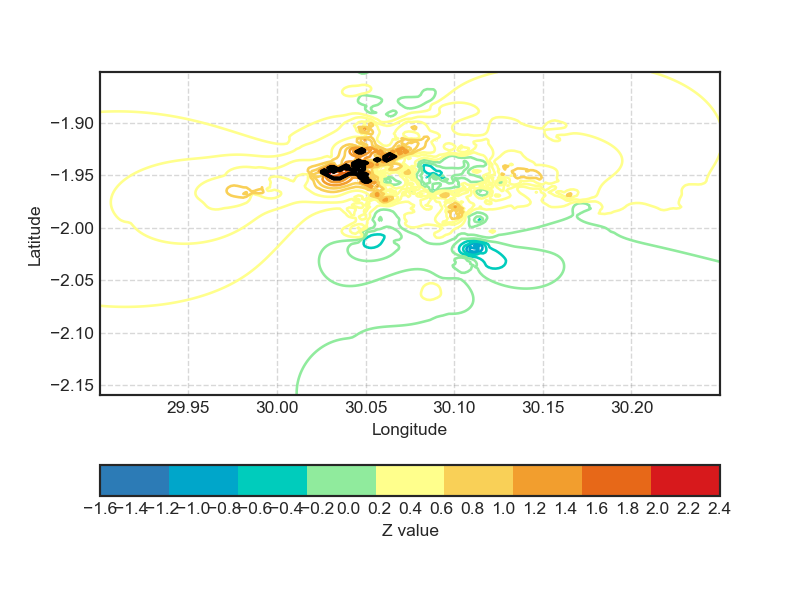

In [12]:
# Plot the contours
plot_contours(df = df_final, level = "z_val", sig_level = 0.05)

In [16]:
# Plot the actual detrended pm2.5 levels across the city - compare to hotspots defined by z-values
df_cleaned = pd.read_csv("data_cleaned_final.csv")
plot_pm25_distribution(df_cleaned)

### 4 Plots for the Paper

We want to compare observations with predicted hotspots. It makes sense then to do this on a 1:1 basis at the tile level. I.e., every observation is assigned to a tile., predictions are made at the tile level, and then predictions and observations are compared for each tile.

#### 4.1 Merge results on a tile by tile basis

Load data:

In [2]:
df_results = pd.read_csv("results_nobracket.csv")
df_cleaned = pd.read_csv("data_cleaned_final.csv")

Re-define tile IDs for cleaned data (already applied: results saved to `data_cleaned_final.csv`)

In [4]:
def redefine_tile_IDs(df_results:pd.DataFrame, df_cleaned: pd.DataFrame) -> pd.DataFrame:
    """
    Args:
        df_results (pd.DataFrame): output from `fitting_process()` 
        df_cleaned (pd.DataFrame): output from `data_preprocess.R`

    Returns:
        df_cleaned (pd.DataFrame): with column `tile_ID_grid` added
    """
    assert 'tile_ID_grid' not in df_cleaned.columns, "Column 'tile_ID_grid' already present in `df_cleaned`"
    print("Redefining tile IDs...")

    # EXTRACT UNIQUE lat, lon FROM df_results

    unique_lat                          = df_results['latitude'].drop_duplicates()
    unique_lon                          = df_results['longitude'].drop_duplicates()

    # ASSIGN NEW TILE ID TO EACH OBSERVATION
    def fetch_nearest_id(lat_obs: float, lon_obs: float, unique_lat: pd.Series, unique_lon: pd.Series, df_results: pd.DataFrame) -> int:
        """
        Fetch the tile ID nearest to the coordinates.

        Args:
            lat_obs (float): latitude of the observation
            lon_obs (float): longitude of the observation
            unique_lat (pd.Series): unique latitude values constituting grid
            unique_lon (pd.Series): unique longitude values constituting grid
            df_results (pd.DataFrame): latitudes, longitudes and IDs
        """
        # closest latitude
        lat_distances   = np.abs(unique_lat - lat_obs)
        min_lat_idx     = lat_distances.idxmin()

        # closest longitude
        lon_distances   = np.abs(unique_lon - lon_obs)
        min_lon_idx     = lon_distances.idxmin()

        # corresponding tile ID
        nearest_tile    = df_results[(df_results['latitude'] == unique_lat[min_lat_idx]) & (df_results['longitude'] == unique_lon[min_lon_idx])]
    
        # assuming there's only one row that matches the condition, fetch the tile ID
        tile_id         = nearest_tile.index.values[0]

        return tile_id

    # enable progress bar
    tqdm.pandas()

    df_cleaned['tile_ID_grid']          = df_cleaned.progress_apply(lambda row: fetch_nearest_id(row['lat'], row['lon'], unique_lat, unique_lon, df_results), axis=1)

    return df_cleaned


Summarise raw data in `df_cleaned` on the tile level

In [5]:
def summarise_by_tile(df_cleaned: pd.DataFrame) -> pd.DataFrame:
    """
    Create DataFrame of summary statistics on the tile level.

    Args:
        df_cleaned (pd.DataFrame): output from `redefine_tile_IDs()`

    Returns:
        df_cleaned_agg (pd.DataFrame): `df_cleaned` with summary statistics on the tile level
    """
    df_cleaned_agg = df_cleaned.groupby('tile_ID_grid').agg(
      max_lon=('lon', 'max'),
      max_lat=('lat', 'max'),
      min_lon=('lon', 'min'),
      min_lat=('lat', 'min'),
      n_measurements=('lon', 'size'),
      med_pm25_detrended_15=('pm25_detrended_15', 'median'),   #median detrended PM25 concentration for each square
      med_pm25=('pm25', 'median')
    ).reset_index()

    df_cleaned_agg = df_cleaned_agg.sort_values(by='tile_ID_grid', ascending=True)

    return df_cleaned_agg

Merge `df_cleaned_agg` with `df_results` on the tile level.

In [6]:
def merge_agg_results(df_cleaned_agg: pd.DataFrame, df_results: pd.DataFrame) -> pd.DataFrame:
    """
    Merge aggregated results and predictions on the tile level.

    Args:
        df_cleaned_agg (pd.DataFrame): output from `summarise_by_tile()`
        df_results (pd.DataFrame): results from `fitting_process()`

    Returns:
        df_merged (pd.DataFrame): results merged on tile grid ID
    """
    df_merged       = df_results.merge(df_cleaned_agg, how='left', left_index=True, right_on='tile_ID_grid')
    df_merged       = df_merged.reset_index(drop=True)
    
    return df_merged

Apply all the above functions for preprocessing.

In [7]:
def prep_data_for_plotting(df_results: pd.DataFrame, df_cleaned: pd.DataFrame) -> pd.DataFrame:
    """
    Aggregate cleaned data by tile and merge with results.

    Args:
      df_results (pd.DataFrame): output from fitting_process()
      df_cleaned (pd.DataFrame): output from data_preprocess.R
    
    Returns:
      df_merged (pd.DataFrame)
    """
    # redefine tile IDs based on grid
    try: df_cleaned                 = redefine_tile_IDs(df_results, df_cleaned)
    except AssertionError: pass

    # aggregate by tile
    df_cleaned_agg                  = summarise_by_tile(df_cleaned)

    # merge
    df_merged                       = merge_agg_results(df_cleaned_agg, df_results)

    # compute p-value w.r.t N(0,1) quantiles
    df_merged['p_value']            = sps.norm.cdf(df_merged['z_val'])
    
    return df_merged

In [8]:
df_merged = prep_data_for_plotting(df_results, df_cleaned)
df_merged.to_csv("df_merged.csv", index=False)

In [ ]:
def summary_statistics(df_merged: pd.DataFrame, alpha: float=0.05) -> pd.DataFrame:
    """
    Produce summary statistics for hotspots identified in `df_merged`.

    Args:
        df_merged (pd.DataFrame): output from `prep_data_for_plotting()`
        alpha (float): desired significance level for hotspot consideration

    Returns:
        df_summary_states (pd.DataFrame): dataframe of summary statistics
    """
    z_crit                  = sps.norm.ppf(q=1-alpha)
    df_merged['hotspot_GP'] = df_merged['z_val'] > z_crit
    k                       = sum(df_merged['hotspot_GP'])

    def top_k_medians(df_merged: pd.DataFrame, k: int):
        """
        Identify hotspots as the K tiles with highest median (raw) pollution.

        Args:
            df_merged (pd.DataFrame): output from `prep_data_for_plotting()`
            k (int): number of hotspots to identify

        Returns:
            hotspot_top_K_medians (pd.Series): column indicating whether tile i is a hotspot
        """
        top_K_tile_IDs  = df_merged.nlargest(K, 'med_pm25').tile_ID_grid
        top_K_tiles     = df_merged['tile_ID_grid'].isin(top_K_tile_IDs)

        return top_K_tiles
    
    df_merged['hotspot_top_K']  = top_k_medians(df_merged, k)

    return df_merged

#### 4.2 Plot results

In [14]:
df_merged = pd.read_csv("df_merged.csv")
data_cleaned_final = pd.read_csv("data_cleaned_final.csv")

In [12]:
data_cleaned_final.head()

,lat,lon,pm25,Date,Time,device,Speed,Date_ft,Time_ft,datetime,...,pm25_detrended_15,pm25_detrended_day,pm25_detrended_comb,tile_id,industrial,major.road,res.road,tile_ID_grid,hour,day_of_week
0,-1.969323,30.087935,83.34,20210901,73415,SPS30_SN:32CAA64C1161ED99,0.8,2021-09-01,07:34:15,2021-09-01 07:34:15+00:00,...,0.000,0.000,0.000,35950.0,0,0,0,21523,7,Wednesday
1,-1.969321,30.087935,83.21,20210901,73416,SPS30_SN:32CAA64C1161ED99,0.4,2021-09-01,07:34:16,2021-09-01 07:34:16+00:00,...,-0.065,-0.065,-0.065,35950.0,0,0,0,21523,7,Wednesday
2,-1.969320,30.087935,82.96,20210901,73418,SPS30_SN:32CAA64C1161ED99,0.3,2021-09-01,07:34:18,2021-09-01 07:34:18+00:00,...,-0.250,-0.250,-0.250,35950.0,0,0,0,21523,7,Wednesday
3,-1.969321,30.087935,82.89,20210901,73419,SPS30_SN:32CAA64C1161ED99,0.6,2021-09-01,07:34:19,2021-09-01 07:34:19+00:00,...,-0.195,-0.195,-0.195,35950.0,0,0,0,21523,7,Wednesday
4,-1.969313,30.087939,82.87,20210901,73420,SPS30_SN:32CAA64C1161ED99,0.2,2021-09-01,07:34:20,2021-09-01 07:34:20+00:00,...,-0.090,-0.090,-0.090,35950.0,0,0,0,21523,7,Wednesday


In [8]:
def plot_pm25_distribution(df_merged: pd.DataFrame, plot_col: str='predicted_value', save: bool=False, map_name: str=None) -> folium.Map:
    """
    Plot grid of PM2.5 quantiles.
    Python rendering of `create_pm25_map()` found in `create_detrended_pm25_map.R`.
        
    Args:
        df_merged (pd.DataFrame): result from `prep_data_for_plotting()`
        plot_col (str): one of 'predicted_value', 'predicted_variance', 'med_pm25_detrended_15', 'med_pm25', 'n_measurements', 'p_value' or 'z_val'
        save (bool): save map? If False, image of map is only displayed
        map_name (str): if saving map, specify the name
               
    Returns:
        m (folium.Map): map of spatial PM2.5 distribution
    """
    
    desc_dict               = { 
        'predicted_value': 'predicted de-trended PM2.5', 
        'predicted_variance': 'predicted variance',
        'med_pm25_detrended_15': 'median de-trended PM2.5', 
        'med_pm25': 'median raw PM2.5',
        'n_measurements': 'number of measurements',
        'p_value':'p value from N(0,1) CDF',
        'z_val': 'z value'
        }
    
    # input checks
    try: plain_text         = desc_dict[plot_col]
    except KeyError: raise KeyError("Unrecognised argument for plot_col.")

    if save: assert map_name is not None, 'Must specify a map name (str) in order to save map'
    
    # Filter out NA
    df_merged               = df_merged.dropna(subset=[plot_col, 'min_lat', 'max_lat', 'min_lon', 'max_lon', 'n_measurements'])

    # compute deciles for colouring polygons
    df_merged['decile']     = pd.qcut(df_merged[plot_col], 10, labels=False)
    decimal_places          = 3 if plot_col in ('z_val', 'p_value') else 1
    df_merged['lim']        = df_merged.groupby('decile')[plot_col].transform('max').round(decimal_places)

    # legend vals
    lim_values              = df_merged.lim.unique().tolist()

    # add minimum
    lim_values.append(round(df_merged[plot_col].min(), decimal_places))
    lim_values.sort()
    min_value, max_value    = df_merged['lim'].min(), df_merged['lim'].max()

    if plot_col == 'p_value':
        lim_values           = [round(p_val, 2) for p_val in np.linspace(0,1,11)]
        min_value, max_value = 0, 1

    # instantiate map
    m = folium.Map(tiles='cartodbpositron', attr='© OpenStreetMap contributors © CARTO')

    # set bounds
    min_lat, min_lon        = df_merged['min_lat'].min(), df_merged['min_lon'].min()
    max_lat, max_lon        = df_merged['max_lat'].max(), df_merged['max_lon'].max()

    # custom colour scale
    colour_scale            = ["#006837", "#1A9850", "#66BD63", "#A6D96A", "#D9EF8B", "#FFFFBF", "#FEE08B","#FDAE61", "#F46D43", "#D73027"]


    # dictionary to colour polygons
    colorMap                = cm.StepColormap(colour_scale, vmin=min_value, vmax=max_value, index=lim_values[1:])

    # title
    title_html = f'''
             <h3 align="center" style="font-size:20px"><b>Kigali: map of {plain_text}</b></h3>
             '''
    m.get_root().html.add_child(folium.Element(title_html))

    
    legend_html = f"""
    <div style="position: fixed; 
                top: 50px; right: 50px; width: 200px; height: 300px; 
                background-color: white; border:2px solid grey; z-index:9999; font-size:14px;">
    <strong>Deciles of {plain_text}:</strong><br>
    """

    for i, val in enumerate(lim_values[1:]):
        color       = colour_scale[i]
        prev_val    = lim_values[i]
        legend_html += f'<i style="background:{color};width:20px;height:20px;display:inline-block;"></i>&nbsp;({prev_val}, {val})<br>'

    legend_html += "</div>"

    # Add custom legend using folium HTML object
    legend = folium.Element(legend_html)
    m.get_root().html.add_child(legend)

    # plot polygons
    for _, row in df_merged.iterrows():
     
     # color criterion
     if plot_col == 'p_value': color_crit = math.ceil(row.p_value * 10)/10
     else: color_crit = row.lim

     rect = folium.Rectangle(
            bounds=[(row['min_lat'], row['min_lon']), (row['max_lat'], row['max_lon'])],
            fill=True,
            fill_opacity=0.7,
            color=None,
            fill_color = colorMap(color_crit)
        )
     rect.add_to(m)

    # fit bounds of the map
    min_lat, min_lon        = df_merged['min_lat'].min(), df_merged['min_lon'].min()
    max_lat, max_lon        = df_merged['max_lat'].max(), df_merged['max_lon'].max()

    delta_lat, delta_lon    = max_lat - min_lat, max_lon - min_lon

    m.fit_bounds([(min_lat + 0.5 * delta_lat, min_lon + 0.2 * delta_lon), (max_lat - 0.2 * delta_lat, max_lon - 0.2 * delta_lon)])

    # save
    if save:
        os.chdir(r"C:\Users\nial\Documents\GitHub\Air-Quality-Gaussian-Process\Paper Plots")
        m.save(f'{map_name}.html')

        print('Saving map html ... Zzz')
        time.sleep(5)

        img_data            = m._to_png(5)
        img                 = Image.open(io.BytesIO(img_data))

        print('Opening map png ... Zzz')
        time.sleep(5)
        img.save(f'{map_name}.png', dpi=(2000,2000))
        
    return m

In [11]:
plot_pm25_distribution(df_merged, plot_col='n_measurements', save=True, map_name='kigali-n-measurements')
plot_pm25_distribution(df_merged, plot_col='med_pm25_detrended_15', save=True, map_name='kigali-detrended-pm25')
plot_pm25_distribution(df_merged, plot_col='predicted_variance', save=True, map_name='kigali-pred-variance')
plot_pm25_distribution(df_merged, plot_col='z_val', save=True, map_name='kigali-z-vals')
plot_pm25_distribution(df_merged, plot_col='p_value', save=True, map_name='kigali-p-vals')

Saving map html ... Zzz
Opening map png ... Zzz
Saving map html ... Zzz
Opening map png ... Zzz
Saving map html ... Zzz
Opening map png ... Zzz
Saving map html ... Zzz
Opening map png ... Zzz
Saving map html ... Zzz
Opening map png ... Zzz


In [ ]:
# data_cleaned_final['datetime'] = data_cleaned_final['datetime'] - pd.Timedelta(hours=2)
# I realised that the datetime is off by exactly two hours...

### 4.3) Data summary plots

We make some plots to summarize the Kigali data for the paper

#### Diurnal pattern plot

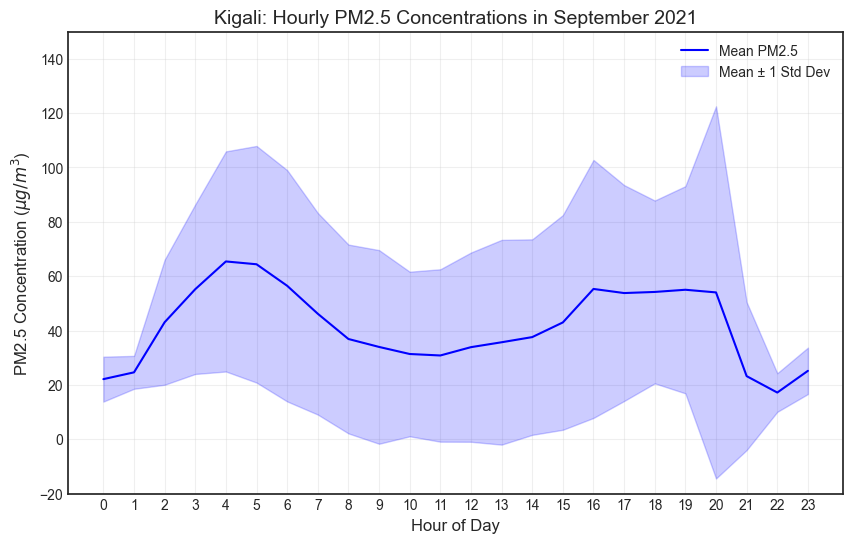

In [ ]:
data_cleaned_final['datetime'] = pd.to_datetime(data_cleaned_final['datetime'])

# Extract hour of the day
data_cleaned_final['hour'] = data_cleaned_final['datetime'].dt.hour

# Group by hour and calculate mean and std
hourly_stats = data_cleaned_final.groupby('hour')['pm25'].agg(['mean', 'std']).reset_index()

# Plot
plt.figure(figsize=(10, 6))
plt.plot(hourly_stats['hour'], hourly_stats['mean'], label='Mean PM2.5', color='blue')
plt.fill_between(
    hourly_stats['hour'],
    hourly_stats['mean'] - hourly_stats['std'],
    hourly_stats['mean'] + hourly_stats['std'],
    color='blue',
    alpha=0.2,
    label='Mean ± 1 Std Dev'
)

# Customize plot
plt.title('Kigali: Hourly PM2.5 Concentrations in September 2021', fontsize=14)
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('PM2.5 Concentration ($ \mu g / m^3$)', fontsize=12)
plt.ylim(-20, 150)
plt.legend()
plt.grid(alpha=0.3)
plt.xticks(range(0, 24))
plt.show()

#### Split by DOTW

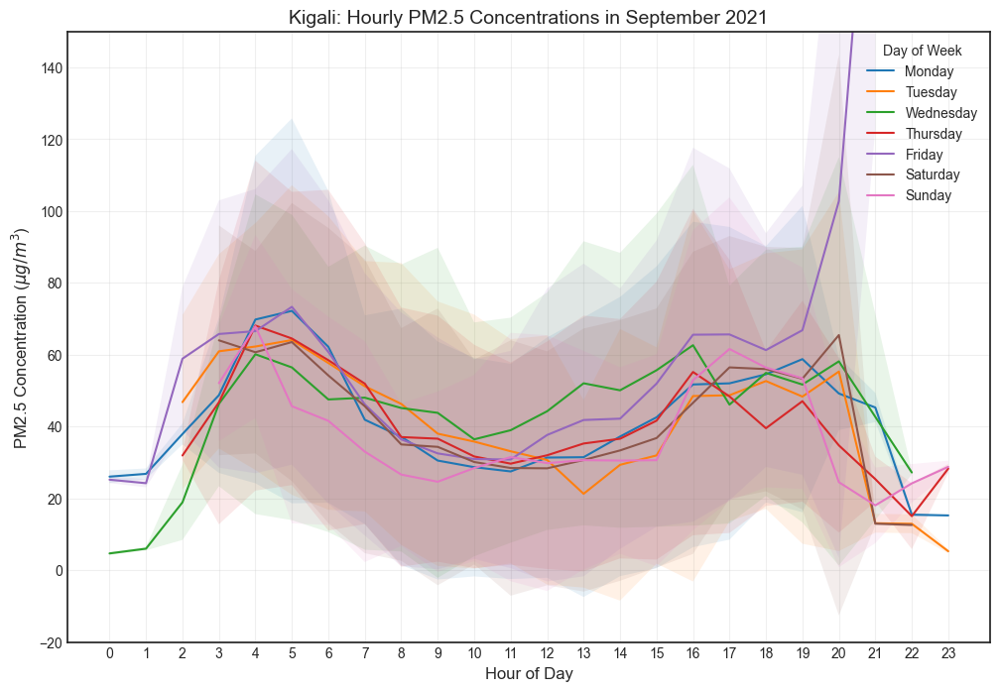

In [23]:
data_cleaned_final['day_of_week'] = data_cleaned_final['datetime'].dt.day_name()

# Group by day of the week and hour, calculate mean and std
grouped_stats = (
    data_cleaned_final.groupby(['day_of_week', 'hour'])['pm25']
    .agg(['mean', 'std'])
    .reset_index()
)

# Ensure days are ordered correctly
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
grouped_stats['day_of_week'] = pd.Categorical(grouped_stats['day_of_week'], categories=day_order, ordered=True)
grouped_stats = grouped_stats.sort_values(['day_of_week', 'hour'])

# Plot
plt.figure(figsize=(12, 8))

for day in day_order:
    day_data = grouped_stats[grouped_stats['day_of_week'] == day]
    plt.plot(day_data['hour'], day_data['mean'], label=day)
    plt.fill_between(
        day_data['hour'],
        day_data['mean'] - day_data['std'],
        day_data['mean'] + day_data['std'],
        alpha=0.1
    )

# Customize plot
plt.title('Kigali: Hourly PM2.5 Concentrations in September 2021', fontsize=14)
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('PM2.5 Concentration ($ \mu g / m^3$)', fontsize=12)
plt.ylim(-20, 150)
plt.legend(title='Day of Week')
plt.grid(alpha=0.3)
plt.xticks(range(0, 24))
plt.show()

In [15]:
row_counts = (
    data_cleaned_final.groupby(['day_of_week', 'hour'])
    .size()
    .reset_index(name='row_count')
)

row_counts_pivot = row_counts.pivot(index='day_of_week', columns='hour', values='row_count').fillna(0)
row_counts_pivot = row_counts_pivot.reindex(day_order)

print(row_counts_pivot)

hour            0       1        2        3        4        5        6   \
day_of_week                                                               
Monday       526.0  1350.0   9417.0  17361.0  26781.0  25727.0  29140.0   
Tuesday      988.0  4294.0   8989.0  17544.0  20805.0  19253.0  14799.0   
Wednesday    625.0  2976.0   7691.0  12400.0  16746.0  17804.0  13623.0   
Thursday      63.0  5337.0  13380.0  31274.0  42922.0  33407.0  28165.0   
Friday       937.0  3904.0  14298.0  20366.0  30783.0  25227.0  22223.0   
Saturday       0.0  2222.0   6489.0  17605.0  17349.0  23895.0  22143.0   
Sunday         0.0  1468.0   3109.0  10716.0  13863.0  15026.0  20489.0   

hour              7        8        9   ...       14       15       16  \
day_of_week                             ...                              
Monday       23712.0  21320.0  24797.0  ...  21524.0  14847.0  17620.0   
Tuesday      15118.0  16831.0  13935.0  ...  12364.0  13955.0  11099.0   
Wednesday    14991.0  14334.

Plot of PM2.5 concentration per day

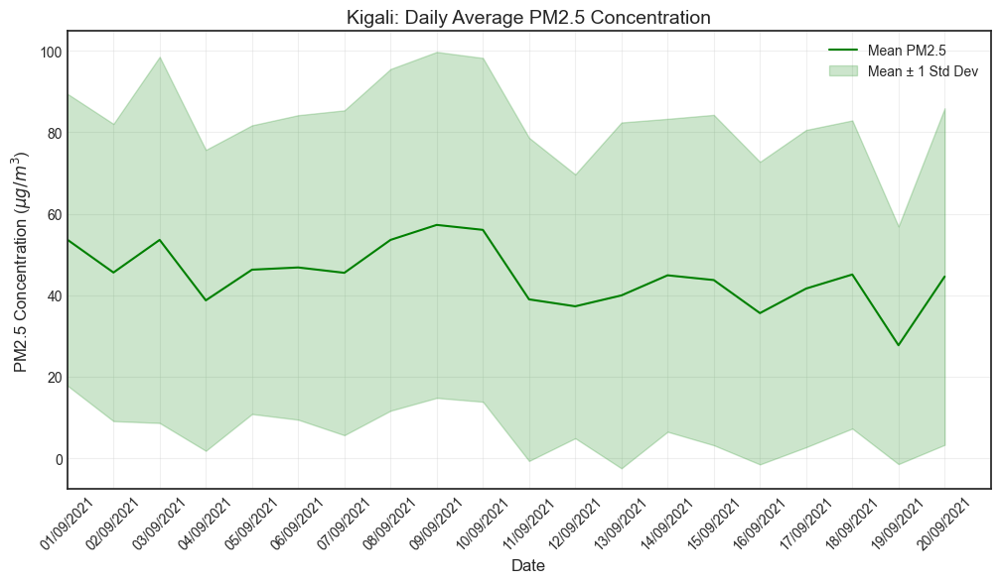

In [48]:
data_cleaned_final['day'] = data_cleaned_final['datetime'].dt.strftime(r"%d/%m/%Y")

# Group by day and calculate mean and std
daily_stats = data_cleaned_final.groupby('day')['pm25'].agg(['mean', 'std']).reset_index()

# Plot
plt.figure(figsize=(12, 6))
plt.plot(daily_stats['day'], daily_stats['mean'], label='Mean PM2.5', color='green')
plt.fill_between(
    daily_stats['day'],
    daily_stats['mean'] - daily_stats['std'],
    daily_stats['mean'] + daily_stats['std'],
    color='green',
    alpha=0.2,
    label='Mean ± 1 Std Dev'
)

# Customize plot
plt.title('Kigali: Daily Average PM2.5 Concentration', fontsize=14)
plt.xlabel('Date', fontsize=12)
plt.ylabel('PM2.5 Concentration ($ \mu g / m^3$)', fontsize=12)
#plt.ylim(-20,150)
plt.xlim(1,20)
plt.legend()
plt.grid(alpha=0.3)
plt.xticks(range(0, 21, 1), rotation=45)
plt.show()

In [34]:
data_cleaned_final['Date'].unique()

array([20210901, 20210902, 20210903, 20210904, 20210905, 20210906,
       20210907, 20210908, 20210909, 20210910, 20210911, 20210912,
       20210913, 20210914, 20210915, 20210916, 20210917, 20210918,
       20210919, 20210920], dtype=int64)

In [49]:
data_cleaned_final.head()

,lat,lon,pm25,Date,Time,device,Speed,Date_ft,Time_ft,datetime,...,pm25_detrended_day,pm25_detrended_comb,tile_id,industrial,major.road,res.road,tile_ID_grid,hour,day_of_week,day
0,-1.969323,30.087935,83.34,20210901,73415,SPS30_SN:32CAA64C1161ED99,0.8,2021-09-01,07:34:15,2021-09-01 07:34:15+00:00,...,0.000,0.000,35950.0,0,0,0,21523,7,Wednesday,01/09/2021
1,-1.969321,30.087935,83.21,20210901,73416,SPS30_SN:32CAA64C1161ED99,0.4,2021-09-01,07:34:16,2021-09-01 07:34:16+00:00,...,-0.065,-0.065,35950.0,0,0,0,21523,7,Wednesday,01/09/2021
2,-1.969320,30.087935,82.96,20210901,73418,SPS30_SN:32CAA64C1161ED99,0.3,2021-09-01,07:34:18,2021-09-01 07:34:18+00:00,...,-0.250,-0.250,35950.0,0,0,0,21523,7,Wednesday,01/09/2021
3,-1.969321,30.087935,82.89,20210901,73419,SPS30_SN:32CAA64C1161ED99,0.6,2021-09-01,07:34:19,2021-09-01 07:34:19+00:00,...,-0.195,-0.195,35950.0,0,0,0,21523,7,Wednesday,01/09/2021
4,-1.969313,30.087939,82.87,20210901,73420,SPS30_SN:32CAA64C1161ED99,0.2,2021-09-01,07:34:20,2021-09-01 07:34:20+00:00,...,-0.090,-0.090,35950.0,0,0,0,21523,7,Wednesday,01/09/2021


In [50]:
df_results = pd.read_csv("results_nobracket.csv")

In [ ]:
df_results.rename({'longitude': 'lon', 'latitude': 'lat'}, axis=1)

,lat,lon,predicted_value,predicted_variance,z_val
0,-2.159996,29.900130,5.193037,1131.591978,0.157050
1,-2.158444,29.900130,5.214554,1130.581225,0.157760
2,-2.156892,29.900130,5.235617,1129.529114,0.158461
3,-2.155340,29.900130,5.256210,1128.433748,0.159150
4,-2.153788,29.900130,5.276317,1127.293226,0.159830
...,...,...,...,...,...
39995,-1.857371,30.249955,1.440168,737.145398,0.056359
39996,-1.855819,30.249955,1.447354,741.753619,0.056447
39997,-1.854267,30.249955,1.454420,746.360959,0.056532
39998,-1.852715,30.249955,1.461358,750.967065,0.056611


In [ ]:
def compute_grid_corners(df_combined: pd.DataFrame) -> pd.DataFrame:
    """
    Compute grid corners for every row in the dataframe `df_combined`.

    Args:
        df_combined (pd.DataFrame): dataframe with lat, lon coordinates in an irregular grid

    Returns:
        df_combined (pd.DataFrame): dataframe with added columns 'min_lat', 'max_lat', 'min_lon', 'max_lon'
    """
    assert all(('lon' in df_combined.columns, 'lat' in df_combined.columns)), "'lon' or 'lat' missing from columns of dataframe" 

    # compute grid corners for a single point
    def compute_grid_corners_row(row_lat: float, row_lon: float, unique_lats: list, unique_lons: list):
        """
        Compute grid corners for a single point specified in `row` of the `df_combined`.
        Assumes that the points belong to an grid with unequal spacing between rows and columns.

        Args:
            row_lat (float): latitude of a point from the `df_combined`
            row_lon (float): longitude of a point from the `df_combined`
            unique_lats (list): unique latitude values in `df_combined`
            unique_lons (list): unique longitude values in `df_combined`

        Returns:
            corners (tuple): (min_lat, max_lat, min_lon, max_lon)
        """
        # index of lat, lon in sorted list
        lat_index, lon_index    = unique_lats.index(row_lat), unique_lons.index(row_lon)

        # next coords
        next_lat, next_lon      = unique_lats[lat_index + 1], unique_lons[lon_index + 1]

        # previous coords
        prev_lat, prev_lon      = unique_lats[lat_index - 1], unique_lons[lon_index - 1]

        # compute coords
        min_lat                 = (prev_lat + row_lat) / 2
        max_lat                 = (next_lat + row_lat) / 2
        min_lon                 = (prev_lon + row_lon) / 2
        max_lon                 = (next_lon + row_lon) / 2

        # return
        return (min_lat, max_lat, min_lon, max_lon)
    
    # extract and sort unique latitudes and longitudes
    unique_lats = sorted(df_combined["lat"].unique())
    unique_lons = sorted(df_combined["lon"].unique())

    # add buffer at beginning and end
    # lon varies by around 0.0003
    # lat varies by around 0.0003

    lat_start_buffer    = min(unique_lats) - 0.0003
    lat_end_buffer      = max(unique_lats) + 0.0003

    lon_start_buffer    = min(unique_lons) - 0.0003
    lon_end_buffer      = max(unique_lons) + 0.0003

    unique_lats.insert(0, lat_start_buffer)
    unique_lats.append(lat_end_buffer)

    unique_lons.insert(0, lon_start_buffer)
    unique_lons.append(lon_end_buffer)

    # apply row-wise function to whole dataframe
    df_combined[['min_lat', 'max_lat', 'min_lon', 'max_lon']] \
        = df_combined.apply(
            lambda row: pd.Series(compute_grid_corners_row(row['lat'], row['lon'], unique_lats, unique_lons))
            , axis=1)
    
    return df_combined


In [55]:
df_merged.rename({'longitude': 'lon', 'latitude': 'lat'}, axis=1, inplace=True)
df_merged = compute_grid_corners(df_merged)
df_merged.head()

,lat,lon,predicted_value,predicted_variance,z_val,tile_ID_grid,max_lon,max_lat,min_lon,min_lat,n_measurements,med_pm25_detrended_15,med_pm25,p_value
0,-2.159996,29.90013,5.193037,1131.591978,0.157050,0,29.901009,-2.159220,29.89998,-2.160146,NaN,NaN,NaN,0.562397
1,-2.158444,29.90013,5.214554,1130.581225,0.157760,1,29.901009,-2.157668,29.89998,-2.159220,NaN,NaN,NaN,0.562677
2,-2.156892,29.90013,5.235617,1129.529114,0.158461,2,29.901009,-2.156116,29.89998,-2.157668,NaN,NaN,NaN,0.562953
3,-2.155340,29.90013,5.256210,1128.433748,0.159150,3,29.901009,-2.154564,29.89998,-2.156116,NaN,NaN,NaN,0.563225
4,-2.153788,29.90013,5.276317,1127.293226,0.159830,4,29.901009,-2.153012,29.89998,-2.154564,NaN,NaN,NaN,0.563492


In [77]:
df_merged.to_csv("df_merged.csv", index=False)